<a href="https://colab.research.google.com/github/qbb-17/Gestion-proyecto-bueno/blob/main/Actividad4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#Cargamos librerias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.special as special
from scipy.optimize import curve_fit
import seaborn as sns
from sklearn.metrics import r2_score

In [2]:
#Cargar archivo xlsx desde COLAB
from google.colab import files
files.upload()

Saving BaseLimpia.xlsx to BaseLimpia.xlsx


{'BaseLimpia.xlsx': b'PK\x03\x04\x14\x00\x06\x00\x08\x00\x00\x00!\x00b\xee\x9dh^\x01\x00\x00\x90\x04\x00\x00\x13\x00\x08\x02[Content_Types].xml \xa2\x04\x02(\xa0\x00\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0

In [3]:
#Carga desde un archivo .xlsx sin indice
bl = pd.read_excel('BaseLimpia.xlsx')
bl.head(5)

,folio,folio_solicitud,precio,enganche,descuento,monto_accesorios,status,fraude,inversion,pagos_realizados,...,fecha_ultimo_pago,fecha_pago_proximo,status_cuenta,razones_buro,cp_cliente,cd_cliente,edo_cliente,cd_venta,edo_venta,curp
0,3,30,1949.0,780.0,0.0,0.0,2,0,0,0,...,Desconocido,Desconocido,Aun no se determina status,Desconocido,Desconocido,0,0,Tantoyuca,Veracruz,AEVM980413MVZNDR02
1,4,33,2999.0,1050.0,0.0,0.0,2,0,0,0,...,Desconocido,Desconocido,Aun no se determina status,Desconocido,Desconocido,PUEBLA,PUE.,Heroica Puebla de Zaragoza,Puebla,ZALC610119MPLPRR07
2,5,37,1959.0,490.0,0.0,0.0,3,0,0,0,...,Desconocido,Desconocido,Cancelado,Desconocido,Desconocido,TANTOYUCA,VER.,0,0,0
3,6,38,1959.0,490.0,0.0,0.0,2,0,0,0,...,Desconocido,Desconocido,Aun no se determina status,Desconocido,Desconocido,AMXTLAN PUE,Desconocido,Zacatlan,Puebla,SAMJ790115MPLNRS02
4,7,44,4299.0,1075.0,0.0,0.0,1,0,0,0,...,2022-03-05 00:00:00,2022-03-12 00:00:00,Mora,Desconocido,Desconocido,TANTOYUCA,VER.,Tantoyuca,Veracruz,TEHF880707HVZRRR07


In [4]:
# Reducimos la selección de variables cuantitativas
bl = bl[['precio', 'costo_total','descuento','monto_financiado','semana','puntos','enganche','pagos_realizados','score_buro','status','porc_eng']]

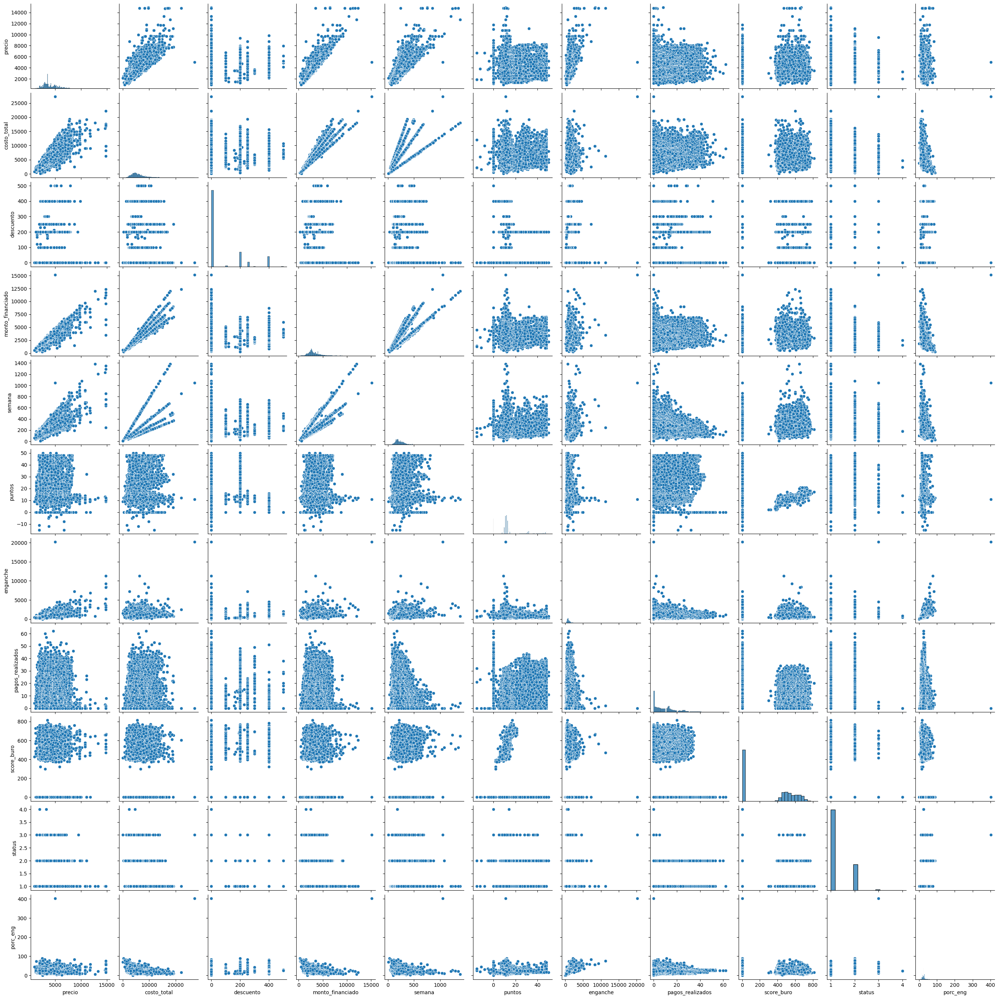

In [5]:
#Graficamos todas las dispersiones entre todas las variables
sns.pairplot(bl)

In [9]:
#Declaramos las variables dependientes e independientes para la regresión No lineal
Vars_Indep= bl[['score_buro']]
Var_Dep= bl['puntos']

In [10]:
#Redefinimos las variables
x= Vars_Indep
y= Var_Dep

Modelo 1

In [11]:
def  func1 (x, a, b, c):
     return a*x**2 + b*x + c

In [12]:
#Ajustamos los parámetros de la función curve_fit
parametros, covs= curve_fit(func1, bl['score_buro'], bl['puntos'])


In [13]:
#Obtenemos los coeficientes del modelo de regresión no lineal
parametros


array([ 4.47691295e-05, -3.56283874e-02,  1.71121942e+01])

In [14]:
#Creamos el modelo de predicción con los parámetros obtenidos
parametros, _ = curve_fit(func1, bl['score_buro'], bl['puntos'])
a, b, c = parametros[ 0 ], parametros[ 1 ], parametros[ 2 ]
yfit1 = a * x ** 2 + b * x + c

In [15]:
#Calculamos las predicciones y reestructuramos el vector de predicciones
#x= x.reshape(51, 1)
#y = y.reshape(51, 1)
#yfit1 = yfit1.reshape(51, 1)
yfit1


,score_buro
0,17.112194
1,17.112194
2,17.112194
3,17.112194
4,17.112194
...,...
22730,10.249943
22731,10.508743
22732,10.190769
22733,14.082193


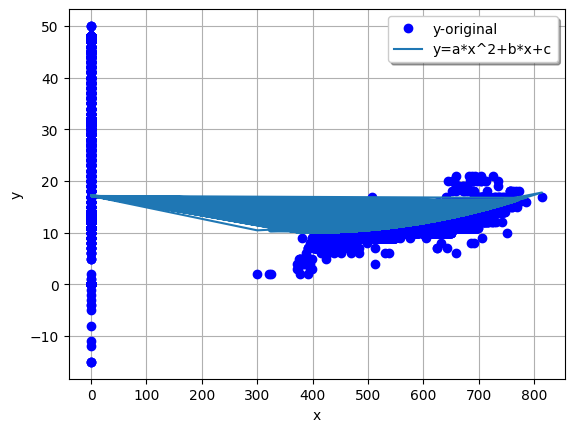

In [16]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label="y-original")
plt.plot(x, yfit1, label="y=a*x^2+b*x+c")
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc='best', fancybox=True, shadow=True)
plt.grid(True)
plt.show()


In [17]:
#Calculamos el coeficiente de determinación del modelo

R2 = r2_score(y, yfit1)
R2


0.06850390871595002

MODELO 2

In [18]:
#Declaramos las variables dependientes e independientes para la regresión No lineal
Vars_Indep= bl[['score_buro']]
Var_Dep= bl['semana']

In [19]:
#Redefinimos las variables
x= Vars_Indep
y= Var_Dep

In [20]:
def  func1 (x, a, b, c):
     return a*x**2 + b*x + c


In [21]:
#Ajustamos los parámetros de la función curve_fit
parametros, covs= curve_fit(func1, bl['score_buro'], bl['semana'])

In [22]:
#Obtenemos los coeficientes del modelo de regresión no lineal
parametros

array([ 3.05807087e-04, -1.56387520e-01,  2.32806612e+02])

In [24]:
#Creamos el modelo de predicción con los parámetros obtenidos
parametros, _ = curve_fit(func1, bl['score_buro'], bl['semana'])
a, b, c = parametros[ 0 ], parametros[ 1 ], parametros[ 2 ]
yfit1 = a * x ** 2 + b * x + c

In [25]:
#Calculamos las predicciones y reestructuramos el vector de predicciones
#x= x.reshape(51, 1)
#y = y.reshape(51, 1)
#yfit1 = yfit1.reshape(51, 1)
yfit1

,score_buro
0,232.806612
1,232.806612
2,232.806612
3,232.806612
4,232.806612
...,...
22730,226.726498
22731,231.364686
22732,225.452483
22733,272.909384


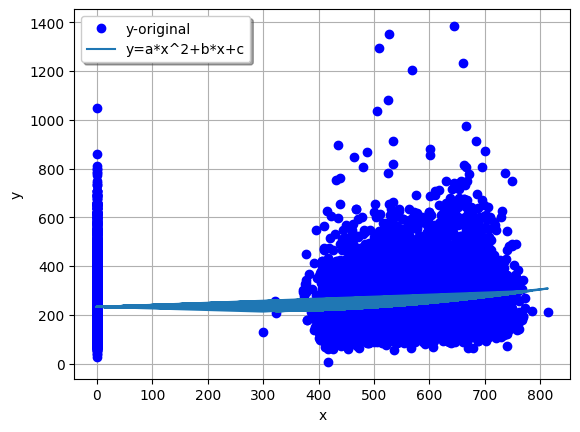

In [26]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label="y-original")
plt.plot(x, yfit1, label="y=a*x^2+b*x+c")
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc='best', fancybox=True, shadow=True)
plt.grid(True)
plt.show()

In [27]:
#Calculamos el coeficiente de determinación del modelo

R2 = r2_score(y, yfit1)
R2


0.015998475010302826

Modelo 3

In [28]:
#Declaramos las variables dependientes e independientes para la regresión No lineal
Vars_Indep= bl[['score_buro']]
Var_Dep= bl['monto_financiado']

In [29]:
#Redefinimos las variables
x= Vars_Indep
y= Var_Dep

In [30]:
def  func1 (x, a, b, c):
     return a*x**2 + b*x + c

In [31]:
#Ajustamos los parámetros de la función curve_fit
parametros, covs= curve_fit(func1, bl['score_buro'], bl['monto_financiado'])

In [32]:
#Obtenemos los coeficientes del modelo de regresión no lineal
parametros

array([ 3.87882518e-03, -2.01845616e+00,  3.02373689e+03])

In [33]:
#Creamos el modelo de predicción con los parámetros obtenidos
parametros, _ = curve_fit(func1, bl['score_buro'], bl['monto_financiado'])
a, b, c = parametros[ 0 ], parametros[ 1 ], parametros[ 2 ]
yfit1 = a * x ** 2 + b * x + c

In [34]:
#Calculamos las predicciones y reestructuramos el vector de predicciones
#x= x.reshape(51, 1)
#y = y.reshape(51, 1)
#yfit1 = yfit1.reshape(51, 1)
yfit1

,score_buro
0,3023.736886
1,3023.736886
2,3023.736886
3,3023.736886
4,3023.736886
...,...
22730,2930.271212
22731,2987.951354
22732,2914.460276
22733,3508.033891


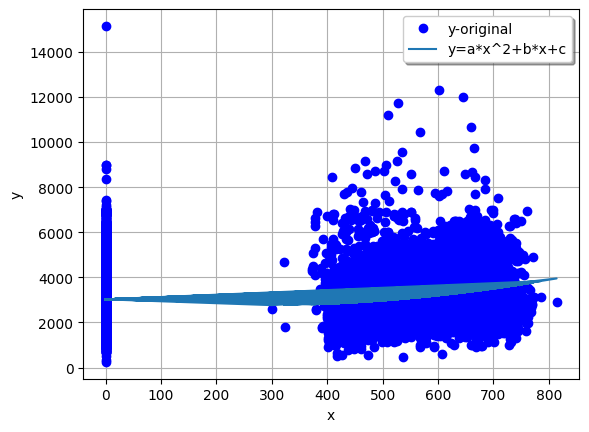

In [35]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label="y-original")
plt.plot(x, yfit1, label="y=a*x^2+b*x+c")
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc='best', fancybox=True, shadow=True)
plt.grid(True)
plt.show()

In [36]:
#Calculamos el coeficiente de determinación del modelo

R2 = r2_score(y, yfit1)
R2


0.020521152817007837

Modelo 4

In [37]:
#Declaramos las variables dependientes e independientes para la regresión No lineal
Vars_Indep= bl[['score_buro']]
Var_Dep= bl['precio']

In [38]:
#Redefinimos las variables
x= Vars_Indep
y= Var_Dep

In [39]:
def  func1 (x, a, b, c):
     return a*x**2 + b*x + c

In [40]:
#Ajustamos los parámetros de la función curve_fit
parametros, covs= curve_fit(func1, bl['score_buro'], bl['precio'])

In [41]:
#Obtenemos los coeficientes del modelo de regresión no lineal
parametros

array([ 1.32256277e-03, -4.02149431e-01,  3.89576453e+03])

In [42]:
#Creamos el modelo de predicción con los parámetros obtenidos
parametros, _ = curve_fit(func1, bl['score_buro'], bl['precio'])
a, b, c = parametros[ 0 ], parametros[ 1 ], parametros[ 2 ]
yfit1 = a * x ** 2 + b * x + c

In [43]:
#Calculamos las predicciones y reestructuramos el vector de predicciones
#x= x.reshape(51, 1)
#y = y.reshape(51, 1)
#yfit1 = yfit1.reshape(51, 1)
yfit1

,score_buro
0,3895.764526
1,3895.764526
2,3895.764526
3,3895.764526
4,3895.764526
...,...
22730,3998.068671
22731,4027.176618
22732,3989.816783
22733,4260.867563


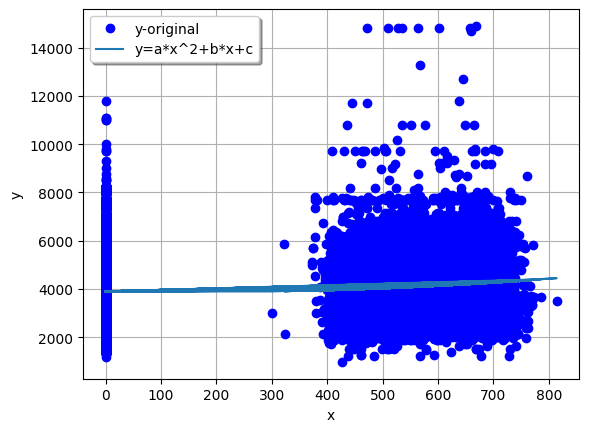

In [44]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label="y-original")
plt.plot(x, yfit1, label="y=a*x^2+b*x+c")
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc='best', fancybox=True, shadow=True)
plt.grid(True)
plt.show()

In [45]:
#Calculamos el coeficiente de determinación del modelo

R2 = r2_score(y, yfit1)
R2

0.0075509012305263745

Modelo 5

In [46]:
#Declaramos las variables dependientes e independientes para la regresión No lineal
Vars_Indep= bl[['score_buro']]
Var_Dep= bl['costo_total']

In [47]:
#Redefinimos las variables
x= Vars_Indep
y= Var_Dep

In [48]:
def  func1 (x, a, b, c):
     return a*x**2 + b*x + c

In [49]:
#Ajustamos los parámetros de la función curve_fit
parametros, covs= curve_fit(func1, bl['score_buro'], bl['costo_total'])

In [50]:
#Obtenemos los coeficientes del modelo de regresión no lineal
parametros

array([ 7.31628239e-03, -3.85586048e+00,  5.61484025e+03])

In [51]:
#Creamos el modelo de predicción con los parámetros obtenidos
parametros, _ = curve_fit(func1, bl['score_buro'], bl['costo_total'])
a, b, c = parametros[ 0 ], parametros[ 1 ], parametros[ 2 ]
yfit1 = a * x ** 2 + b * x + c

In [52]:
#Calculamos las predicciones y reestructuramos el vector de predicciones
#x= x.reshape(51, 1)
#y = y.reshape(51, 1)
#yfit1 = yfit1.reshape(51, 1)
yfit1

,score_buro
0,5614.840251
1,5614.840251
2,5614.840251
3,5614.840251
4,5614.840251
...,...
22730,5415.738476
22731,5522.930717
22732,5386.401980
22733,6494.336667


In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label="y-original")
plt.plot(x, yfit1, label="y=a*x^2+b*x+c")
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc='best', fancybox=True, shadow=True)
plt.grid(True)
plt.show()

In [54]:
#Calculamos el coeficiente de determinación del modelo

R2 = r2_score(y, yfit1)
R2

0.014674108394057028